**Utilise Tensorflow v2**

/!\ Attention, avec Tensorflow v2.14, l'installation du GPU ne fonctionne pas

# Paramétrage

## Librairies

In [ ]:
# partie spécifique Google Colab
!pip install tensorflow==2.15.0 rasterio plotly scikit-image shapely
!pip install ultralytics
!pip install rasterio plotly scikit-image shapely

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 40.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 750.8/750.8 kB 2.9 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manyli

In [ ]:
import numpy as np
import glob
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import cv2
import pandas as pd
import tqdm
from datetime import date
from google.colab import drive
import random
import matplotlib.pyplot as plt
import os
import math
from pathlib import Path
import shutil
from PIL import Image, ImageOps
from io import BytesIO
import requests
import matplotlib as mpl
import matplotlib.pyplot as plt

import geopandas as gpd
import rasterio
import shapely
import skimage as ski
from skimage.measure import find_contours, approximate_polygon, subdivide_polygon, label

from sklearn.model_selection import train_test_split
from sklearn.base import BaseEstimator, ClassifierMixin
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_absolute_error, accuracy_score
from sklearn.base import TransformerMixin, BaseEstimator
from sklearn.pipeline import Pipeline

import tensorflow as tf
from tensorflow import image as tf_image
from tensorflow import data as tf_data
from tensorflow import io as tf_io

import keras
from keras import layers, Model, backend
from keras.layers import Input, Rescaling, Dense, Dropout, Flatten, Conv2D, Conv2DTranspose, \
MaxPooling2D, AveragePooling2D, SpatialDropout2D, BatchNormalization, Activation, SeparableConv2D, \
UpSampling2D, GlobalAveragePooling2D
from keras.models import Sequential, load_model
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau, ModelCheckpoint
from keras.utils import load_img, img_to_array, array_to_img

import torch
import torchvision

from ultralytics import YOLO
from ultralytics.engine.results import Results, Boxes
from ultralytics.models.yolo.detect.predict import DetectionPredictor
from ultralytics.utils import DEFAULT_CFG, ops
from ultralytics.nn.tasks import attempt_load_weights
from ultralytics.utils.torch_utils import intersect_dicts
from ultralytics.utils.ops import xywh2xyxy, non_max_suppression


## Configuration GPU

In [ ]:
print(keras.__version__)
print(tf.__version__)
print(tf.test.gpu_device_name())
print(tf.config.list_physical_devices())

2.15.0
2.15.0

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]


## Données

In [ ]:
# partie spécifique Google Colab
!mkdir -p /content/data/decoupe_final
!cp /content/drive/MyDrive/data/DST/df_decoupe_final.csv /content/data/decoupe_final/df_decoupe_final.csv
!unzip /content/drive/MyDrive/data/DST/decoupe_final.zip -d /content/data/decoupe_final

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
 extracting: /content/data/decoupe_final/decoupe_final/69-2020_8_834400.0_22_6508200.0_33.cpg  
  inflating: /content/data/decoupe_final/decoupe_final/69-2020_8_834400.0_22_6508200.0_33.dbf  
  inflating: /content/data/decoupe_final/decoupe_final/69-2020_8_834400.0_22_6508200.0_33.jp2  
  inflating: /content/data/decoupe_final/decoupe_final/69-2020_8_834400.0_22_6508200.0_33.prj  
  inflating: /content/data/decoupe_final/decoupe_final/69-2020_8_834400.0_22_6508200.0_33.shp  
  inflating: /content/data/decoupe_final/decoupe_final/69-2020_8_834400.0_22_6508200.0_33.shx  
 extracting: /content/data/decoupe_final/decoupe_final/69-2020_8_834400.0_22_6508200.0_33_data.jpg  
  inflating: /content/data/decoupe_final/decoupe_final/69-2020_8_834400.0_22_6508200.0_33_data.jpg.aux.xml  
  inflating: /content/data/decoupe_final/decoupe_final/69-2020_8_834400.0_22_6508200.0_33_label.png  
  inflating: /content/data/decoupe

In [ ]:
data_path = '/content/data/decoupe_final'
images_path = '/content/data/decoupe_final/decoupe_final'
df_decoupe = pd.read_csv(data_path + '/df_decoupe_final.csv')
df_decoupe.head()

,dalle_X,dalle_Y,X,Y,X_size,Y_size,fichier_raster,fichier_img,fichier_mask,fichier_shapes,formes,multi,erreur
0,0,0,825000.0,6509800.0,1000,1000,69-2020_0_825000.0_0_6509800.0_0.jp2,69-2020_0_825000.0_0_6509800.0_0_data.jpg,69-2020_0_825000.0_0_6509800.0_0_label.png,69-2020_0_825000.0_0_6509800.0_0.shp,0,0,0
1,0,1,825000.0,6509600.0,1000,1000,69-2020_1_825000.0_0_6509600.0_0.jp2,69-2020_1_825000.0_0_6509600.0_0_data.jpg,69-2020_1_825000.0_0_6509600.0_0_label.png,69-2020_1_825000.0_0_6509600.0_0.shp,0,0,0
2,0,2,825000.0,6509400.0,1000,1000,69-2020_2_825000.0_0_6509400.0_4.jp2,69-2020_2_825000.0_0_6509400.0_4_data.jpg,69-2020_2_825000.0_0_6509400.0_4_label.png,69-2020_2_825000.0_0_6509400.0_4.shp,4,0,0
3,0,3,825000.0,6509200.0,1000,1000,69-2020_3_825000.0_0_6509200.0_4.jp2,69-2020_3_825000.0_0_6509200.0_4_data.jpg,69-2020_3_825000.0_0_6509200.0_4_label.png,69-2020_3_825000.0_0_6509200.0_4.shp,4,0,0
4,0,4,825000.0,6509000.0,1000,1000,69-2020_4_825000.0_0_6509000.0_19.jp2,69-2020_4_825000.0_0_6509000.0_19_data.jpg,69-2020_4_825000.0_0_6509000.0_19_label.png,69-2020_4_825000.0_0_6509000.0_19.shp,19,0,0


## Fonctions

In [ ]:
def predict_YOLOv8_CPU(image, model, seuil):
  '''
  fonction de prédiction "flat", tous les masques sont applatis
  usage du CPU
  on ne prédit que la classe "0", bâtiments
  '''
  res = model.predict(image, save = False, classes = [0], imgsz = SIZE, conf = seuil, verbose=False)
  if len(res[0]) > 0:
    mask = np.sum(res[0].masks.data.cpu().numpy(), 0)
    mask = np.clip(mask, 0, 1)
  else:
    mask = [np.zeros((size_model, size_model))]
  return [mask]

In [ ]:
def predict_YOLOv8(file_name, model, seuil, flatten = False):
  '''
  on ne prédit que la classe "0", bâtiments
  '''
  res = model.predict(file_name, save = False, classes = [0], imgsz = SIZE, conf = seuil, verbose=False)
  if len(res[0]) > 0:
    if flatten:
      mask_res = tf.convert_to_tensor(torch.sum(res[0].cuda().masks.data, 0).cpu())
      mask_list = [tf.clip_by_value(mask_res, 0, 1)]
    else:
      mask_res = res[0].cuda().masks.data
      mask_list = [tf.convert_to_tensor(mask_res[i].cpu()) for i in range(mask_res.shape[0])]
  else:
    mask_list = [tf.zeros((SIZE, SIZE))]
  return mask_list

In [ ]:
def predict_YOLOv8_flat(file_name, model, seuil):
  '''
  on ne prédit que la classe "0", bâtiments
  seul un masque "applati" est retourné, mais dans une liste (de longueur 1)
  '''
  res = model.predict(file_name, save = False, classes = [0], imgsz = SIZE, conf = seuil, verbose=False)
  if len(res[0]) > 0:
    mask_res = tf.convert_to_tensor(torch.sum(res[0].cuda().masks.data, 0).cpu())
    mask_list = [tf.clip_by_value(mask_res, 0, 1)]
  else:
    mask_list = [tf.zeros((SIZE, SIZE))]
  return mask_list

In [ ]:
def predict_YOLOv8_compareligne(file_name, model, seuil):
  res = model.predict(file_name, save = False, imgsz = SIZE, conf = seuil, verbose=False)
  if len(res[0]) > 0:
    mask = tf.convert_to_tensor(torch.sum(res[0].cuda().masks.data, 0).cpu())
    mask = tf.clip_by_value(mask, 0, 1)
  else:
    mask = tf.zeros((SIZE, SIZE))
  return mask

In [ ]:
def calcul_iou_mask(masque1, masque2, min_pixel = 1):
  if not masque1.shape==masque2.shape:
    print("masques de tailles incompatibles")
    return None
  else:
    M1 = masque1 > 0
    M2 = masque2 > 0
    return (min_pixel + np.sum(M1 & M2))/(min_pixel + np.sum(M1 | M2))

In [ ]:
def calcul_ious_shapes(shapes_1_ext, shapes_2_ext, seuil_iou = 0):
  '''
  fonction qui calcule l'IoU des shapes_1_ext en cherchant à rapprocher les shapes_2_ext
  renvoie la liste des ious calculés
  '''
  ious = []
  rapprochements = []
  selected_intersections = []
  for i in range(len(shapes_1_ext)):
    shape_1 = shapely.Polygon(shapes_1_ext[i])
    unions = []
    unions.append(shape_1)
    intersections = []
    for j in range(len(shapes_2_ext)):
      shape_2 = shapely.Polygon(shapes_2_ext[j])
      if shape_2 is not None:
        if shape_1.intersects(shape_2):
          intersection = shape_1.intersection(shape_2)
          intersections.append(intersection)
          unions.append(shape_2)
    if len(intersections) > 0:
      all_intersections = gpd.GeoSeries(intersections, crs = 2154).unary_union
      intersection_area = shapely.area(all_intersections)
    else:
      intersection_area = 0
    union_area = shapely.area(gpd.GeoSeries(unions, crs = 2154).unary_union)
    if union_area == 0:
      ious.append(0)
    else:
      iou = intersection_area/union_area
      ious.append(iou)
      if len(intersections) > 0 and iou > seuil_iou:
        selected_intersections.append(all_intersections)
    rapprochements.append(len(intersections))
  return ious, rapprochements, selected_intersections

In [ ]:
def isInMap(xrange, yrange, bounds = False):
    '''
    fonction qui renvoie une autre fonction permettant de tester si une forme
    est à l'intérieur d'un restangle défini par xrange, yrange
    si l'argument "bounds" est mis à True, la fonction renvoyée réalise le test sur la base de l'emprise rectangulaire de la forme
    sinon, la fonction renvoyée réalise le test sur la base du centroïd
    l'argument "bounds" est à False par défaut
    '''
    def my_function(polynom):
        if bounds:
            minx, miny, maxx, maxy = polynom.bounds
        else:
            centroid_x, centroid_y = polynom.centroid.x, polynom.centroid.y
            minx, miny, maxx, maxy = centroid_x, centroid_y, centroid_x, centroid_y
        if xrange[0] < minx and xrange[1] > maxx and yrange[0] < miny and yrange[1] > maxy:
            return(True)
        else:
            return(False)
    return my_function

In [ ]:
def affiche_contours_iou(
    model, predict_function, df, chemin_images, index_l, resolution_model, resolution_target = (1000, 1000),
    image = None,
    seuil = None, seuil_iou = 0, coord_transform = None, gdf_shapes_ref = None, affichage = True, delta_only = False,
    seuil_area = 10,
    types_ref = ['BATIMENT'],
    tolerance_polygone = 0.1):
  '''
  fonction qui calcule les IoU des formes prédites par rapport à des formes de référence
  utilise les mêmes arguements que compare_ligne, avec en plus :
  - predict_function : fonction qui prend en argument le triplet (image, model, seuil) et qui renvoie une liste de prévisions du modèle "model" sous forme
  de masque numpy.array avec les dimensions correspondant au paramètre "resolution_model", pour le seuil de détection "seuil"
  /!\ predict_function doit pouvoir faire l'inférence sur l'image et non pas sur le chemin file_name
  - image : array de l'image sur laquelle faire la prédiction, si renseigné, utilisé à la place de l'image à l'index index_l
  - seuil_iou : les formes avec un IoU inférieur sont affichées en rouge
  - delta_only : si True, n'affiche que les formes en rouge
  - coord_transform : transformation affine pour passer des pixels aux coordonnées géographiques cible
  - gdf_shapes_ref : fichier de shapefiles à utiliser pour la comparaison des formes prédites > par défaut, on compare par rapport aux formes du df_decoupe
  renvoie :
  - geoSeries avec les formes prédites, crs 2154, avec uniquement les contours
  - geoSeries avec les formes de réference, crs 2154, avec uniquement les contours, et en fusionnant les formes adjacentes
  - shapes_pred_ious
  - shapes_ref_ious
  - le calcul de l'iou "pixel par pixel"
  '''
  # image sur laquelle faire l'inférence
  if image is None:
    file_name = chemin_images + df.loc[index_l,'fichier_img']
    image = Image.open(file_name)

  # Prévision
  prev_masks = predict_function(image, model, seuil)
  # Contours prédiction
  mask_contours = []
  for prev_mask in prev_masks:
    prev_mask_resized = tf.squeeze(tf_image.resize(images = np.expand_dims(prev_mask, -1), size = resolution_target, method = 'nearest'))
    mask_padded = np.pad(prev_mask_resized, ((1, 1),(1, 1)), mode = 'constant', constant_values = 0)
    mask_contours += ski.measure.find_contours(image = mask_padded == 1)

  # utilisation des informations raster pour les coordonnées
  if coord_transform is None:
    raster_name = chemin_images + df.loc[index_l, 'fichier_raster']
    with rasterio.open(raster_name) as raster:
      # création du convertisseur pour passer des coordonnées en pixels
      raster_transform = raster.transform
      bounds = raster.bounds
  else:
    X0, Y0, coords_scale = coord_transform
    raster_transform = rasterio.transform.Affine(coords_scale, 0.0, X0,
                              0.0, -coords_scale, Y0 + coords_scale*resolution_target[1])
    bounds = rasterio.coords.BoundingBox(X0, Y0, X0 + coords_scale*resolution_target[0], Y0 + coords_scale*resolution_target[1])

  # Shapes référence
  if gdf_shapes_ref is None:
    # on charge les informations de la découpe
    shape_name = chemin_images + df.loc[index_l, 'fichier_shapes']
    gdf_shapes_ref_copy = gpd.read_file(shape_name)
  else:
    # on charge les informations du fichier fourni
    gdf_shapes_ref_copy = gdf_shapes_ref.copy()
  # on ne garde que le type de formes de référence spécifié, si applicable
  if types_ref is not None and len(list(set(gdf_shapes_ref_copy.columns) & set(types_ref))):
    gdf_shapes_ref_copy = gdf_shapes_ref_copy[gdf_shapes_ref_copy['Type'].isin(types_ref)]
  # on enlève les shapes extérieurs à la dalle pour diminuer le volume de données inutiles
  img_bound = shapely.Polygon(((bounds.left, bounds.bottom), (bounds.right, bounds.bottom), (bounds.right, bounds.top), (bounds.left, bounds.top), (bounds.left, bounds.bottom)))
  try:
    gdf_shapes_ref_copy['geometry'] = gdf_shapes_ref_copy['geometry'].intersection(img_bound)
    gdf_shapes_ref_copy = gdf_shapes_ref_copy[
      ~(gdf_shapes_ref_copy['geometry'].isna() | gdf_shapes_ref_copy['geometry'].is_empty)]
  except:
    # si erreur, on fait un test simple
    gdf_shapes_ref_copy = gdf_shapes_ref_copy[gdf_shapes_ref_copy['geometry'].apply(isInMap([bounds.left, bounds.right], [bounds.bottom, bounds.top], False))]

  # Shapes prédiction
  raster_transformer = rasterio.transform.AffineTransformer(raster_transform)
  shapes_xy = []
  shapes_predict = []
  # parcours de tous les contours prédits
  for contour in mask_contours:
    # on crée le polygone
    polygon = approximate_polygon(contour, tolerance = tolerance_polygone)
    # on tranforme en coordonnées
    xy_polygon = raster_transformer.xy(polygon[:,0], polygon[:,1])
    shapes_xy.append(xy_polygon)
    # on crée le polygone
    shapes_predict.append(shapely.Polygon(np.array(xy_polygon).transpose()))
  # on filtre les surface trop petites
  shapes_predict = [shape for shape in shapes_predict if shapely.area(shape) > seuil_area]
  # Ajout des trous dans les shapes prédiction
  shapes_predict_holes = []
  shapes_holes = []
  for shape_a in shapes_predict:
    if shape_a not in shapes_holes:
      shape_a_holes = []
      for shape_b in shapes_predict:
        if shape_a.contains_properly(shape_b):
          shape_a_holes.append(shape_b.exterior)
          shapes_holes.append(shape_b)
      if len(shape_a_holes) > 0:
        shapes_predict_holes.append(shapely.Polygon(shape_a.exterior, holes = shape_a_holes))
      else:
        shapes_predict_holes.append(shape_a)
  gdf_shapes_predict = gpd.GeoDataFrame(geometry = gpd.GeoSeries(shapes_predict_holes, crs=2154), crs=2154)

  # /!\ on court-circuite le traitement de fusion pour éviter de supprimer des formes de référence
  '''
  # Regroupement et fusion des formes adjacentes
  gdf_shapes_ref['group'] = ''
  for index in range(gdf_shapes_ref.shape[0]):
    group = gdf_shapes_ref[~gdf_shapes_ref.geometry.disjoint(gdf_shapes_ref.geometry[index])].index.to_list()
    if len(group) > 1:
      if gdf_shapes_ref.loc[index, 'group'] == '':
        gdf_shapes_ref.loc[group, 'group'] = 'group_' + str(index)
      else:
        gdf_shapes_ref.loc[group, 'group'] = gdf_shapes_ref.loc[index, 'group']
  gdf_shapes_ref_merged = gdf_shapes_ref.dissolve(by = 'group', as_index = False)
  gdf_shapes_ref_merged = gdf_shapes_ref_merged[gdf_shapes_ref_merged['geometry'].is_valid].reset_index()
  '''

  # Intersection et IoUs
  shapes_ref = gdf_shapes_ref_copy['geometry'].exterior
  shapes_ref = [shape for shape in shapes_ref if shape is not None]
  shapes_predict = gdf_shapes_predict['geometry'].exterior
  shapes_predict = [shape for shape in shapes_predict if shape is not None]
  # iou des prédictions
  shapes_pred_ious, shapes_pred_rapprochements, _ = calcul_ious_shapes(shapes_predict, shapes_ref)
  # iou des réferences
  shapes_ref_ious, shapes_ref_rapprochements, _ = calcul_ious_shapes(shapes_ref, shapes_predict)

  # IoU "pixel par pixel"
  # Masque
  mask_name = chemin_images + df.loc[index_l,'fichier_mask']
  image_mask = tf.io.read_file(mask_name)
  image_mask = tf.image.decode_png(image_mask, channels = 1)
  image_mask = tf.where(tf.math.greater(image_mask, 0), 1, 0)
  mask_reduit = tf.squeeze(tf.image.resize(images = image_mask, size = resolution_model, method = 'nearest'))

  # Métrique IoU
  prev_mask = prev_masks[0]
  m_IoU = calcul_iou_mask(mask_reduit, prev_mask)

  fig = None
  if affichage:
    # génération du graphique
    X0 = bounds.left
    Y0 = bounds.top
    nb_formes = len(shapes_ref)
    fig = px.imshow(
        #cv2.flip(raster_data, 0),
        ImageOps.flip(image),
        x = np.linspace(bounds.left, bounds.right, resolution_target[0]),
        y = np.linspace(bounds.bottom, bounds.top, resolution_target[1]),
        title = 'Image {}, {}<br>{} bâtiments référence<br>{} zones détectées'.format(
            str(X0), str(Y0), str(nb_formes),
            np.sum((np.array(shapes_pred_ious) <= seuil_iou) & (np.array(shapes_pred_rapprochements) == 0))),
        origin = 'lower')
    # ajout des formes
    shape_traces_to_plot = []
    if not delta_only:
      # formes de référence
      for shape, iou, rapprochement in zip(shapes_ref, shapes_ref_ious, shapes_ref_rapprochements):
        list_x, list_y = shape.xy
        shape_traces_to_plot.append(
            go.Scatter(
                x = np.array(list_x),
                y = np.array(list_y),
                line = dict(color='black', width=1),
                mode = 'lines',
                fill = 'toself',
                fillcolor = '#80b1d3',
                opacity = 0.4,
                text = 'iou référence: {}<br>{} prédictions rapprochées'.format(iou, rapprochement),
                hoverinfo = 'text',
                showlegend = False))
    # formes prédites
    for shape, iou, rapprochement in zip(shapes_predict, shapes_pred_ious, shapes_pred_rapprochements):
      list_x, list_y = shape.xy
      if iou <= seuil_iou:
        shape_traces_to_plot.append(
          go.Scatter(
              x = np.array(list_x),
              y = np.array(list_y),
              line = dict(color='black', width=1),
              mode = 'lines',
              fill = 'toself',
              fillcolor = 'red',
              opacity = 0.4,
              text = 'iou prédiction: {}'.format(iou),
              hoverinfo = 'text',
              showlegend = False))
      elif not delta_only:
        shape_traces_to_plot.append(
          go.Scatter(
              x = np.array(list_x),
              y = np.array(list_y),
              line = dict(color='black', width=1),
              mode = 'lines',
              fill = 'toself',
              fillcolor = '#ffed6f',
              opacity = 0.4,
              text = 'iou prédiction: {}<br>{} bâtiments rapprochés'.format(iou, rapprochement),
              hoverinfo = 'text',
              showlegend = False))

    fig.add_traces(shape_traces_to_plot)
    # mise en forme
    fig.update_layout(
        xaxis=dict(title='X en Lambert93'),
        yaxis=dict(title='Y en Lambert93'),
        plot_bgcolor='white',
        height = 900,
        width = 900)

  return shapes_predict, shapes_ref, shapes_pred_ious, shapes_ref_ious, shapes_pred_rapprochements, shapes_ref_rapprochements, m_IoU, fig


# Grad cam YOLO v8

Application de la technique GradCam sur un modèle YOLOv8

**Pour les besoins du gradCam, et l'utilisation d'un tensor en source d'inférence, il faut utiliser la dernière version du package ultralytics**

Sources :

+ package [pytorch-grad-cam](https://github.com/jacobgil/pytorch-grad-cam)
+ package [YOLO-V8-CAM](https://github.com/rigvedrs/YOLO-V8-CAM)
+ [dépôt](https://github.com/z1069614715/objectdetection_script/blob/master/yolo-gradcam/yolov8_heatmap.py) avec un exemple qui semble fonctionner

In [ ]:
SIZE = 512
RESOLUTION = (SIZE, SIZE)

path_model_saved = '/content/drive/MyDrive/DataScientest/YOLO/YOLOv8_20240124/weights/best.pt'
model_saved = YOLO(path_model_saved)


Pour visualiser et analyser le modèle, on l'export au format standard ONNX

In [ ]:
model_saved.export(format='onnx')

Ultralytics YOLOv8.1.34 🚀 Python-3.10.12 torch-2.2.1+cu121 CPU (Intel Xeon 2.00GHz)
YOLOv8m-seg summary (fused): 245 layers, 27225279 parameters, 0 gradients, 110.0 GFLOPs

PyTorch: starting from '/content/drive/MyDrive/DataScientest/YOLO/YOLOv8_20240124/weights/best.pt' with input shape (1, 3, 512, 512) BCHW and output shape(s) ((1, 41, 5376), (1, 32, 128, 128)) (52.3 MB)
requirements: Ultralytics requirement ['onnx>=1.12.0'] not found, attempting AutoUpdate...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 278.7 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 7.3s, installed 1 package: ['onnx>=1.12.0']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.16.0 opset 17...
ONNX: export success ✅ 9.6s, saved as '/content/drive/MyDrive/DataScientest/YOLO/YOLOv8_20240124/weights/best.onnx' (104.0 MB)

Export complete (12.1s)
Results saved to /content/drive/MyDrive/DataScientest/YOLO/YOLOv8_20240124/weights
Predic

'/content/drive/MyDrive/DataScientest/YOLO/YOLOv8_20240124/weights/best.onnx'

In [ ]:
def predict_YOLOv8_tensor(img_data, model, seuil, flatten = True):
  '''
  fonction test pour vérifier que l'on peut utiliser un tensor
  '''
  img_tensor = torch.from_numpy(np.expand_dims(np.asarray(torchvision.transforms.functional.resize(img_data, RESOLUTION)).transpose(2, 0, 1)/255, 0)).to(torch.float32)

  res = model.predict(img_tensor, save = False, classes = [0], imgsz = SIZE, conf = seuil, verbose=False)
  if len(res[0]) > 0:
    if flatten:
      mask_res = tf.convert_to_tensor(torch.sum(res[0].cuda().masks.data, 0).cpu())
      mask_list = [tf.clip_by_value(mask_res, 0, 1)]
    else:
      mask_res = res[0].cuda().masks.data
      mask_list = [tf.convert_to_tensor(mask_res[i].cpu()) for i in range(mask_res.shape[0])]
  else:
    mask_list = [tf.zeros((SIZE, SIZE))]
  return mask_list

## Choix de la photo

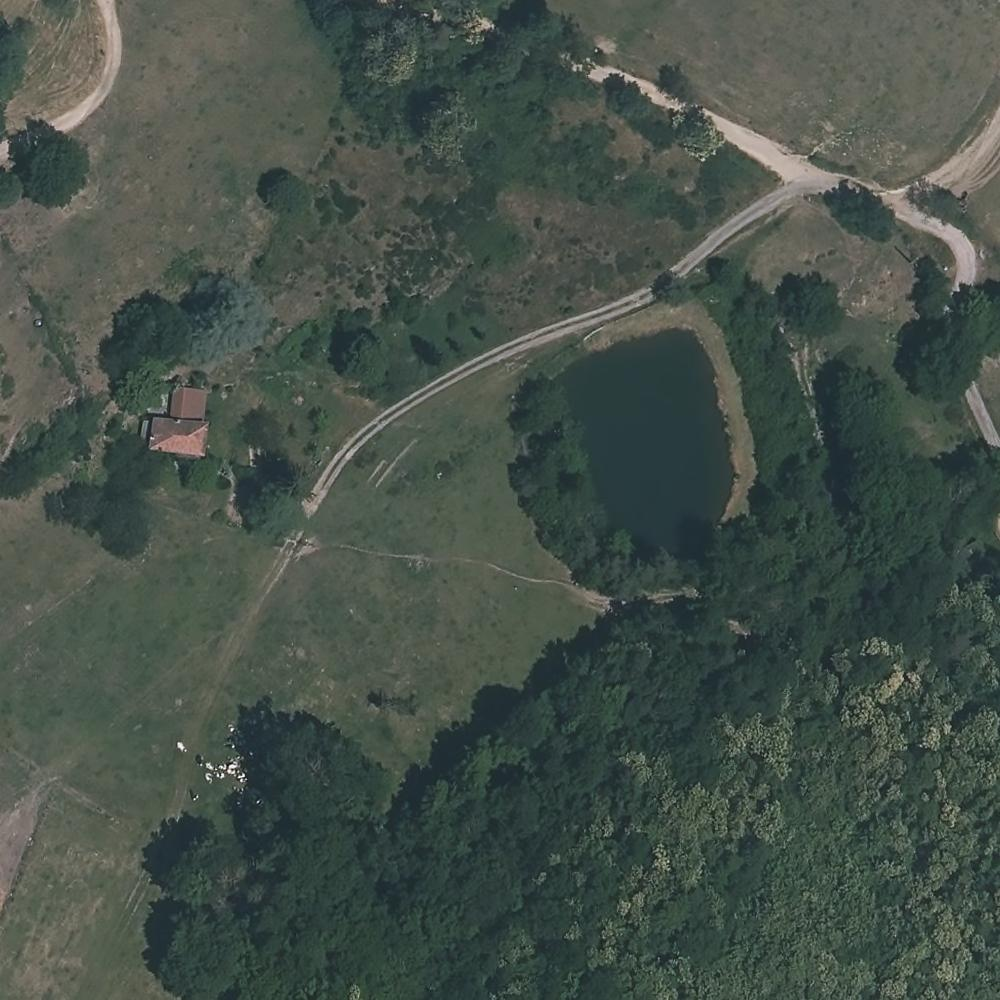

In [ ]:
nb_formes = 2
index = df_decoupe[df_decoupe['formes']==nb_formes].index.values
np.random.shuffle(index)
image = Image.open(images_path + '/' + df_decoupe.loc[index[0],'fichier_img'])
image

In [ ]:
index[0]

1389

In [ ]:
# i_img = 6148
i_img = 6799
i_img = 1124
_, _, _, _, _, _, _, fig = affiche_contours_iou(
    model_saved, predict_YOLOv8_CPU, df_decoupe, images_path + '/', i_img,
    RESOLUTION, resolution_target = (1000, 1000), types_ref = None,
    seuil = 0.01, seuil_iou = 0.01, gdf_shapes_ref = None, affichage = True,
    seuil_area = 30)
fig.show()

## Détail du modèle

On compare l'exécution directe de la fonction du modèle, et l'exécution par étapes :

+ application du modèle "brut"
+ application par étape des fonctions de post-processing de la librairie ultralytics (NMS et process_mask)

Import d'une image dans un tensor et paramètres

**/!\ pour utiliser un tensor, il faut la dernière version d'ultralytics**

In [ ]:
index_l = 6022
image = Image.open(images_path + '/' + df_decoupe.loc[index_l,'fichier_img'])
input_tensor = torch.from_numpy(np.expand_dims(np.asarray(torchvision.transforms.functional.resize(image, RESOLUTION)).transpose(2, 0, 1)/255, 0)).to(torch.float32)
conf_threshold = 0.01
iou_threshold = 0.7
predict_classes = [0]
n_classes = len(model_saved.names)

Etapes de la librairie YOLO

In [ ]:
# calcul "brut"
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
input_tensor = input_tensor.to(device)
raw_result = model_saved.model(input_tensor)

In [ ]:
p = ops.non_max_suppression(
    raw_result[0],
    conf_thres = conf_threshold,
    iou_thres = iou_threshold,
    nc = n_classes,
    classes = predict_classes)
pred = p[0]
proto = raw_result[1][-1]
masks = ops.process_mask(proto[0], pred[:, 6:], pred[:, :4], RESOLUTION, upsample=True)
boxes = Boxes(pred[:, :6], input_tensor.shape[2:])

In [ ]:
masks.shape

torch.Size([287, 512, 512])

In [ ]:
boxes.conf.shape

torch.Size([287])

In [ ]:
boxes.xyxy.shape

torch.Size([287, 4])

On vérifie que l'on obtient bien la même sortie avec la fonction "packagée" de la bibliothèque


In [ ]:
result = model_saved.predict(input_tensor, save = False, classes = predict_classes, imgsz = SIZE, conf = conf_threshold, iou = iou_threshold, verbose=False)

In [ ]:
result[0].masks.shape

torch.Size([287, 512, 512])

In [ ]:
result[0].boxes.conf.shape

torch.Size([287])

In [ ]:
result[0].boxes.data.shape

torch.Size([287, 6])

## Mise en oeuvre

In [ ]:
class yolov8_ActivationsAndGradients:

    def __init__(self, model, target_layers, conf_threshold, n_classes, predict_class):
        self.model = model
        self.gradients = []
        self.activations = []
        self.handles = []
        for target_layer in target_layers:
            self.handles.append(
                target_layer.register_forward_hook(self.save_activation))
            # voir https://github.com/pytorch/pytorch/issues/61519 : il n'est pas possible d'utiliser un backward hook
            self.handles.append(
                target_layer.register_forward_hook(self.save_gradient))
        self.conf_threshold = conf_threshold
        self.n_classes = n_classes
        self.predict_classes = predict_classes

    def save_activation(self, module, input, output):
      activation = output
      # /!\ on peut ajouter les résultats à la suite car on est en "forward"
      self.activations.append(activation.cpu().detach())

    def save_gradient(self, module, input, output):
      if not hasattr(output, 'requires_grad') or not output.requires_grad:
        return

      def _store_grad(grad):
        # /!\ il faut ajouter les résultats dans le sens inverse car on est en "backward"
        self.gradients = [grad.cpu().detach()] + self.gradients

      output.register_hook(_store_grad)

    def post_process(self, result):
      # batch = 1
      x = result[0][0]
      x = x.transpose(-1, -2)
      # on filtre sur le seuil de confiance et la classe cible
      confs, j = x[:,4:4 + self.n_classes].max(1, keepdim=True)
      x = x[(torch.logical_and(j == torch.tensor([0], device=x.device), confs > self.conf_threshold)).any(1)]
      # séparation des données
      box, cls, logits = x.split((4, self.n_classes, x.shape[1] - self.n_classes - 4), 1)
      # autre donnée
      result_data = result[1][1][0]
      result_data = result_data.transpose(-1, -2)
      # on filtre sur le seuil de confiance et la classe cible
      result_data = result_data[(torch.logical_and(j == torch.tensor([0], device=x.device), confs > self.conf_threshold)).any(1)]
      # proto /!\ pas de gradient possible
      # proto_data = result[1][-1][0]
      # proto_data = torch.reshape(proto_data, (proto_data.shape[0], -1))
      return box, cls, logits, result_data

    def __call__(self, x):
        self.gradients = []
        self.activations = []
        model_output = self.model(x)
        boxes, conf, logits, result_data = self.post_process(model_output)
        return [boxes, conf, logits, result_data]

    def release(self):
        for handle in self.handles:
            handle.remove()

In [ ]:
class yolov8_GradCamLoss(torch.nn.Module):
    def __init__(self) -> None:
        super().__init__()

    def forward(self, result_data):
      loss = 0
      for data in result_data:
        for i in range(data.shape[0]):
          for j in range(data.shape[1]):
            loss += data[i, j]
      return loss


In [ ]:
class yolov8_GradCamLoss_box(torch.nn.Module):
    def __init__(self) -> None:
        super().__init__()

    def forward(self, result_data, boxes_data):
      loss = 0
      for data in result_data:
        for i in range(boxes_data.shape[0]):
          x1 = boxes_data[i][0]
          y1 = boxes_data[i][1]
          x2 = boxes_data[i][2]
          y2 = boxes_data[i][3]
          loss += data[y1:y2, x1:x2].sum()
      return loss

In [ ]:
def make_gradCam_heatmap(image, model_GradCam, model, target_layers, conf_threshold, n_classes, predict_classes,
                         result_display = 'cam_heatmap', normalize_boxes = False, abs_norm = False, norm_grads_act = False,
                         boxes_only = False, abs_values = False,
                         names_result = ['boxes', 'conf', 'logits masques', 'other', 'all'],
                         img_weigth = 0.5):
  # préparation des images
  image_array = np.asarray(image)
  # on redimensionne l'image de départ à la taille de la sortie du modèle
  image_array_resized = cv2.resize(image_array, RESOLUTION)
  # pour les calculs de gradient
  input_tensor = torch.from_numpy(np.expand_dims(np.asarray(torchvision.transforms.functional.resize(image, RESOLUTION)).transpose(2, 0, 1)/255, 0)).to(torch.float32)

  # coordonnées des boxes prédites par le modèle
  result = model.predict(input_tensor, save = False, classes = predict_classes, imgsz = SIZE, conf = conf_threshold, iou = iou_threshold, verbose=False)
  boxes_coords = result[0].boxes.data[:,:4].cpu().detach().numpy().astype(np.int32)

  # données de sorties de la fonction
  dict_heatmaps = {}

  # initialisation du modèle pour le calcul de gradient
  for weight in model_GradCam.parameters():
    weight.requires_grad = True
  model_GradCam.eval()

  # passe forward
  print('passe forward ...')
  activations_and_grads = yolov8_ActivationsAndGradients(model_GradCam, target_layers, conf_threshold, n_classes, predict_classes)
  forward_results = activations_and_grads(input_tensor)

  # on ne poursuit que s'il y a des résultats
  if forward_results[0].shape[0] > 0:
    forward_results = forward_results + [forward_results]

    print('passe backward ...')
    # passe backward pour toutes les combinaisons layer x type de résultat
    for forward_result, name_result in zip(forward_results, names_result):
      print(name_result)
      # dictionnaire des valeurs
      dict_heatmaps[name_result] = {}
      dict_heatmaps[name_result]['layers'] = {}

      # échelle pour la normalisation des valeurs
      heatmap_min = 0
      heatmap_max = 0

      # passe backward
      if boxes_only:
        loss_function = yolov8_GradCamLoss_box()
        model_GradCam.zero_grad()
        if isinstance(forward_result, list):
          loss = loss_function(forward_result, boxes_coords)
        else:
          loss = loss_function([forward_result], boxes_coords)
      else:
        loss_function = yolov8_GradCamLoss()
        model_GradCam.zero_grad()
        if isinstance(forward_result, list):
          loss = loss_function(forward_result)
        else:
          loss = loss_function([forward_result])
      loss.backward(retain_graph=True)

      # récupération des activations et des gradients pour chaque target layer
      activations_list = [a.cpu().data.numpy() for a in activations_and_grads.activations]
      grads_list = [g.cpu().data.numpy() for g in activations_and_grads.gradients]
      for id_layer, (activations, grads) in enumerate(zip(activations_list, grads_list)):
        dict_heatmaps[name_result]['layers'][id_layer] = {}
        if norm_grads_act:
          dict_heatmaps[name_result]['layers'][id_layer]['activations'] = (np.squeeze(activations) - np.min(activations)) / (np.max(activations) - np.min(activations))
          dict_heatmaps[name_result]['layers'][id_layer]['gradients'] = (np.squeeze(grads) - np.min(grads)) / (np.max(grads) - np.min(grads))
        else:
          dict_heatmaps[name_result]['layers'][id_layer]['activations'] = np.squeeze(activations)
          dict_heatmaps[name_result]['layers'][id_layer]['gradients'] = np.squeeze(grads)
        if abs_values:
          dict_heatmaps[name_result]['layers'][id_layer]['activations'] = np.abs(dict_heatmaps[name_result]['layers'][id_layer]['activations'])
          dict_heatmaps[name_result]['layers'][id_layer]['gradients'] = np.abs(dict_heatmaps[name_result]['layers'][id_layer]['gradients'])
        dict_heatmaps[name_result]['layers'][id_layer]['cam_heatmap'] = np.squeeze(activations) * np.squeeze(grads)
        # mise à jour du min/max
        heatmap_min = min(heatmap_min, np.min(dict_heatmaps[name_result]['layers'][id_layer]['cam_heatmap']))
        heatmap_max = max(heatmap_max, np.max(dict_heatmaps[name_result]['layers'][id_layer]['cam_heatmap']))

      # sauvegarde du min/max
      dict_heatmaps[name_result]['heatmap_min'] = heatmap_min
      dict_heatmaps[name_result]['heatmap_max'] = heatmap_max

      # réinitialisation des gradients
      activations_and_grads.gradients = []

    # création des images superposées
    print('création des images ...')
    all_normalized_heatmap = []
    for id_layer in range(len(target_layers)):
      for name_result in names_result:
        if id_layer in dict_heatmaps[name_result]['layers'].keys():
          heatmap_data = np.sum(dict_heatmaps[name_result]['layers'][id_layer][result_display], 0)
          heatmap = cv2.resize(heatmap_data, RESOLUTION)
          if normalize_boxes:
            # on extrait la heatmap pour chaque box
            blank_heatmaps = []
            for i in range(boxes_coords.shape[0]):
              blank_heatmap = np.zeros(RESOLUTION, dtype=np.float32)
              x1 = boxes_coords[i][0]
              y1 = boxes_coords[i][1]
              x2 = boxes_coords[i][2]
              y2 = boxes_coords[i][3]
              heatmap_crop = heatmap[y1:y2, x1:x2].copy()
              blank_heatmap[y1:y2, x1:x2] = heatmap_crop
              blank_heatmaps.append([blank_heatmap])
            heatmap = np.max(np.concatenate(blank_heatmaps), 0)
          if abs_norm:
            normalized_heatmap = (heatmap - dict_heatmaps[name_result]['heatmap_min']) / (dict_heatmaps[name_result]['heatmap_max'] - dict_heatmaps[name_result]['heatmap_min'])
          else:
            normalized_heatmap = (heatmap - np.min(heatmap)) / (np.max(heatmap) - np.min(heatmap))
          all_normalized_heatmap.append(normalized_heatmap)
          # conversion de la heatmap en couleurs
          jet = mpl.colormaps['jet']
          jet_colors = jet(np.arange(256))[:, :3]
          jet_heatmap = jet_colors[np.uint8(255 * normalized_heatmap)] * 255
          superposed_img = jet_heatmap * (1 - img_weigth) + image_array_resized * img_weigth
          dict_heatmaps[name_result]['layers'][id_layer]['superposed_heatmap'] = np.uint8(superposed_img)
        else:
          dict_heatmaps[name_result]['layers'][id_layer] = {}
          dict_heatmaps[name_result]['layers'][id_layer]['superposed_heatmap'] = np.zeros(RESOLUTION + (3,), dtype=np.uint8)

      # création de la heatmap moyenne
      normalized_heatmaps = np.concatenate([np.expand_dims(cv2.resize(normalized_heatmap, (512, 512)), 0) for normalized_heatmap in all_normalized_heatmap])
      normalized_heatmap_mean = np.mean(normalized_heatmaps, 0)
      jet = mpl.colormaps['jet']
      jet_colors = jet(np.arange(256))[:, :3]
      jet_heatmap = jet_colors[np.uint8(255 * normalized_heatmap_mean)] * 255
      superposed_img = jet_heatmap * (1 - img_weigth) + image_array_resized * img_weigth
      dict_heatmaps[name_result]['mean_superposed_heatmap'] = np.uint8(superposed_img)

    return dict_heatmaps


In [ ]:
SIZE = 512
RESOLUTION = (SIZE, SIZE)
path_model_saved = '/content/drive/MyDrive/DataScientest/YOLO/YOLOv8_20240124/weights/best.pt'
model_saved = YOLO(path_model_saved)
# pour le GradCam, on travaille avec le modèle et non l'objet YOLO
model_GradCam = YOLO(path_model_saved).model
conf_threshold = 0.01
iou_threshold = 0.7
predict_classes = [0]
n_classes = len(model_saved.names)

In [ ]:
# layers cibles > TOUS
target_layers_idx = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 15, 16, 18, 19, 21]
target_layers = [model_GradCam.model[i] for i in target_layers_idx]

In [ ]:
# layers cibles > convolutions
import ultralytics
target_layers = sum(([model_GradCam.model[i].cv1, model_GradCam.model[i].cv2] for i in target_layers_idx if type(model_GradCam.model[i]) == ultralytics.nn.modules.block.C2f), [])

In [ ]:
# layers cibles > convolutions du dernier module
# blocks cvx
import ultralytics
all_last_layers = model_GradCam.model[22].cv2 + model_GradCam.model[22].cv3 + model_GradCam.model[22].cv4
all_last_layers_blocks = ['cv2']*len(model_GradCam.model[22].cv2) + ['cv3']*len(model_GradCam.model[22].cv3) + ['cv4']*len(model_GradCam.model[22].cv4)
target_layers_info = [(layer, block_name + '_' + str(j) + '_' + str(i)) for (j, (sequence, block_name)) in enumerate(zip(all_last_layers, all_last_layers_blocks)) for i, layer in enumerate(sequence) if type(layer) in [ultralytics.nn.modules.conv.Conv, torch.nn.modules.conv.Conv2d]]
target_layers = [layer for (layer, _) in target_layers_info]
target_layers_idx = [info for (_, info) in target_layers_info]

In [ ]:
# index_l = 6148
index_l = 1124
# index_l = 1389
image = Image.open(images_path + '/' + df_decoupe.loc[index_l,'fichier_img'])

In [ ]:
dict_heatmaps = make_gradCam_heatmap(image, model_GradCam, model_saved, target_layers, conf_threshold, n_classes, predict_classes,
                                     result_display = 'cam_heatmap', normalize_boxes = False, abs_norm = False, norm_grads_act = False,
                                     abs_values = True, boxes_only = False)

passe forward ...
passe backward ...
boxes
conf
logits masques
other
all
création des images ...


<ipython-input-76-195087d7648f>:113: RuntimeWarning:

invalid value encountered in divide

<ipython-input-76-195087d7648f>:118: RuntimeWarning:

invalid value encountered in cast

<ipython-input-76-195087d7648f>:130: RuntimeWarning:

invalid value encountered in cast



In [ ]:
result_name = 'all'
superposed_heatmaps = np.concatenate([np.expand_dims(cv2.resize(dict_heatmaps[result_name]['layers'][layer_id]['superposed_heatmap'], (512, 512)), 0) for layer_id in dict_heatmaps[result_name]['layers'].keys()])
fig = px.imshow(superposed_heatmaps, animation_frame=0)
fig.update_layout(
    height = 900,
    width = 900)
#fig.write_html('/content/drive/MyDrive/DataScientest/YOLO/gradcam_{}.html'.format(result_name))
fig.show()

In [ ]:
names_result_show = ['boxes', 'conf', 'logits masques']

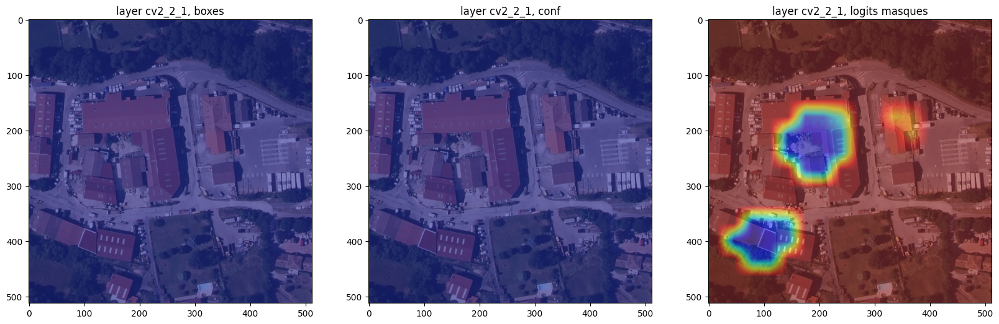

In [ ]:
layer_id = target_layers_idx.index('cv2_2_1')
fig, axs = plt.subplots(1, len(names_result_show), figsize = (20, 6))
for col, name_result in enumerate(names_result_show):
  superimposed_img = dict_heatmaps[name_result]['layers'][layer_id]['superposed_heatmap']
  axs[col].imshow(superimposed_img)
  axs[col].set_title('layer {}, {}'.format(target_layers_idx[layer_id], name_result))
plt.show()

In [ ]:
layer_id = target_layers_idx.index('cv2_0_2')
superimposed_img = dict_heatmaps['logits masques']['layers'][layer_id]['superposed_heatmap']
px.imshow(superimposed_img)

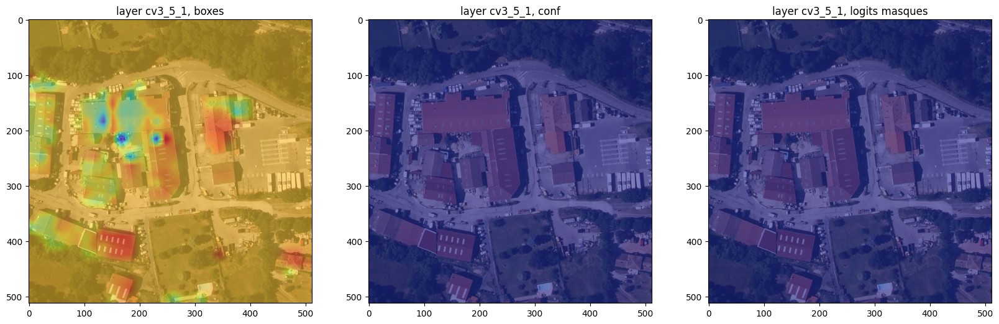

In [ ]:
layer_id = target_layers_idx.index('cv3_5_1')
fig, axs = plt.subplots(1, len(names_result_show), figsize = (20, 6))
for col, name_result in enumerate(names_result_show):
  superimposed_img = dict_heatmaps[name_result]['layers'][layer_id]['superposed_heatmap']
  axs[col].imshow(superimposed_img)
  axs[col].set_title('layer {}, {}'.format(target_layers_idx[layer_id], name_result))
plt.show()

In [ ]:
layer_id = target_layers_idx.index('cv3_5_2')
superimposed_img = dict_heatmaps['boxes']['layers'][layer_id]['superposed_heatmap']
px.imshow(superimposed_img)

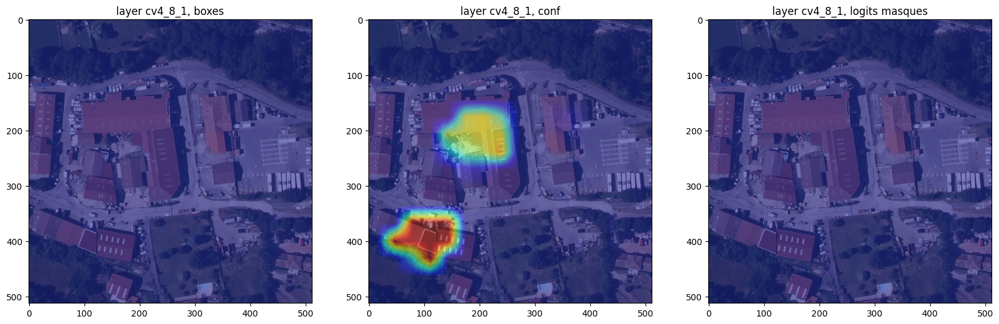

In [ ]:
layer_id = target_layers_idx.index('cv4_8_1')
fig, axs = plt.subplots(1, len(names_result_show), figsize = (20, 6))
for col, name_result in enumerate(names_result_show):
  superimposed_img = dict_heatmaps[name_result]['layers'][layer_id]['superposed_heatmap']
  axs[col].imshow(superimposed_img)
  axs[col].set_title('layer {}, {}'.format(target_layers_idx[layer_id], name_result))
plt.show()

In [ ]:
layer_id = target_layers_idx.index('cv4_6_0')
superimposed_img = dict_heatmaps['conf']['layers'][layer_id]['superposed_heatmap']
px.imshow(superimposed_img)

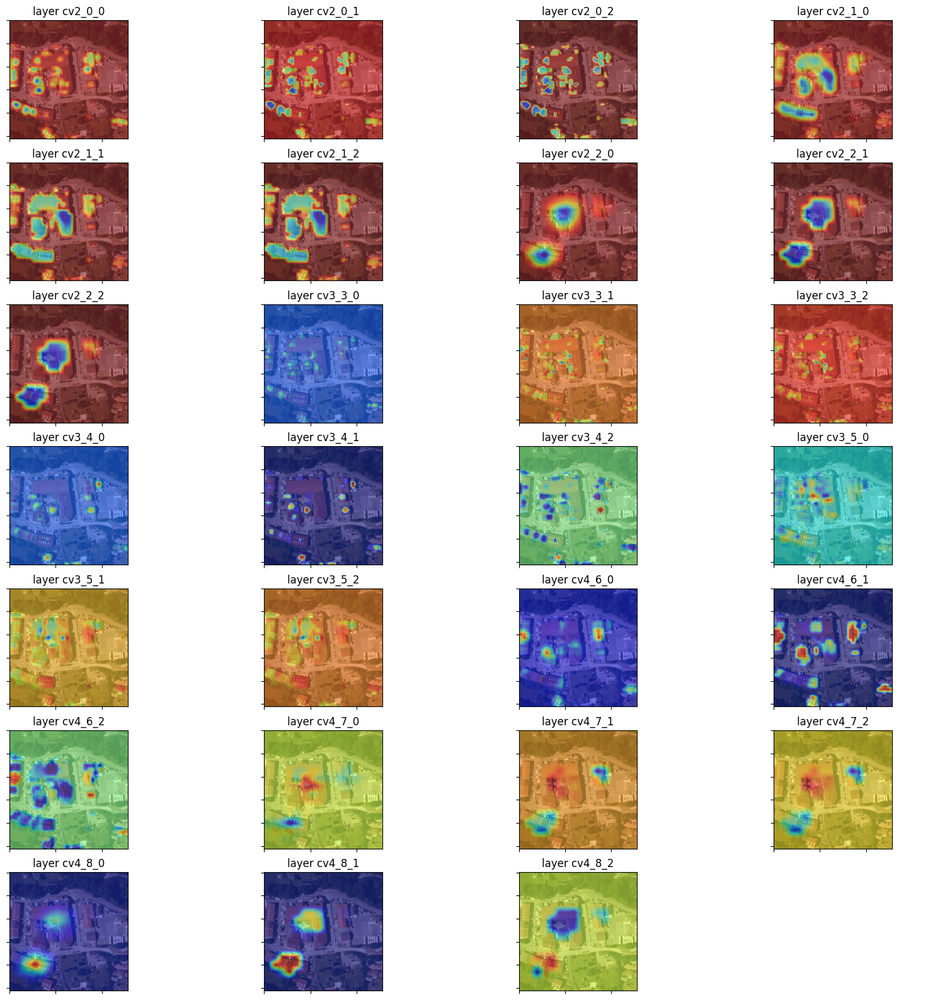

In [ ]:
result_name = 'all'
fig, axs = plt.subplots(int(np.ceil(len(dict_heatmaps[result_name]['layers'].keys()) / 4)), 4, figsize = (20, 20))
for col in range(4):
  for row in range(int(np.ceil(len(dict_heatmaps[result_name]['layers'].keys()) / 4))):
    if col + row*4 < len(dict_heatmaps[result_name]['layers'].keys()):
      superimposed_img = dict_heatmaps[result_name]['layers'][col + row*4]['superposed_heatmap']
      axs[row, col].imshow(superimposed_img)
      axs[row, col].set_title('layer {}'.format(target_layers_idx[col + row*4]))
      axs[row, col].set(xticklabels=[])
      axs[row, col].set(yticklabels=[])
    else:
      axs[row, col].axis('off')
plt.show()

## Streamlit

In [ ]:
X_size = Y_size = 1000
coords_scale = 0.2
X0 = 644326.03
Y0 = 6860333.65

raster_transform = rasterio.transform.Affine(coords_scale, 0.0, X0,
                          0.0, coords_scale, Y0)
xmin, ymin = raster_transform*(0, 0)
xmax, ymax = raster_transform*(X_size, Y_size)
request_wms = 'https://data.geopf.fr/wms-r?LAYERS=HR.ORTHOIMAGERY.ORTHOPHOTOS&FORMAT=image/tiff&SERVICE=WMS&VERSION=1.3.0&REQUEST=GetMap&STYLES=&CRS=EPSG:2154&BBOX={},{},{},{}&WIDTH={}&HEIGHT={}'.format(
   xmin, ymin, xmax, ymax, X_size, Y_size)
response_wms = requests.get(request_wms).content
image = Image.open(BytesIO(response_wms))

In [ ]:
# préparation des images
image_array = np.asarray(image)
# on redimensionne l'image de départ à la taille de la sortie du modèle
image_array_resized = cv2.resize(image_array, RESOLUTION)
# pour les calculs de gradient
input_tensor = torch.from_numpy(np.expand_dims(np.asarray(torchvision.transforms.functional.resize(image, RESOLUTION)).transpose(2, 0, 1)/255, 0)).to(torch.float32)


## YOLO-V8-CAM

Test du package [YOLO-V8-CAM](https://github.com/rigvedrs/YOLO-V8-CAM)

In [ ]:
! git clone https://github.com/rigvedrs/YOLO-V8-CAM.git

Cloning into 'YOLO-V8-CAM'...
remote: Enumerating objects: 78, done.
remote: Counting objects: 100% (21/21), done.
remote: Compressing objects: 100% (18/18), done.
remote: Total 78 (delta 7), reused 11 (delta 3), pack-reused 57
Receiving objects: 100% (78/78), 29.77 MiB | 15.53 MiB/s, done.
Resolving deltas: 100% (20/20), done.


In [ ]:
%cd YOLO-V8-CAM/

/content/YOLO-V8-CAM


In [ ]:
!pip install ttach

In [ ]:
from yolo_cam.eigen_cam import EigenCAM
from yolo_cam.utils.image import show_cam_on_image, scale_cam_image
from typing import Callable, List, Tuple

In [ ]:
img = cv2.imread(images_path + '/' + df_decoupe['fichier_img'].values[7428])
img = cv2.resize(img, (512, 512))
rgb_img = img.copy()
img = np.float32(img) / 255

In [ ]:
target_layers = [model_saved.model.model[-4]]

In [ ]:
target_layers

[Conv(
   (conv): Conv2d(384, 384, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
   (act): SiLU(inplace=True)
 )]

In [ ]:
model_saved.model.zero_grad()

In [ ]:
cam = EigenCAM(model_saved, target_layers,task='seg')
grayscale_cam = cam(rgb_img, target_layers)[0, :, :]
cam_image = show_cam_on_image(img, grayscale_cam, use_rgb=True)
px.imshow(cam_image)



0: 512x512 52 BATIMENTs, 31.7ms
Speed: 3.2ms preprocess, 31.7ms inference, 2.8ms postprocess per image at shape (1, 3, 512, 512)


In [ ]:
_, _, _, _, _, _, _, fig = affiche_contours_iou(
    model_saved, predict_YOLOv8, df_decoupe, images_path + '/', 7428,
    RESOLUTION, resolution_target = (1000, 1000), types_ref = None,
    seuil = 0.25, seuil_iou = 0.01, gdf_shapes_ref = None, affichage = True,
    seuil_area = 30)
fig.show()

# Keras Unet

In [ ]:
def predict_Unet(file_name, model, seuil):
  image = tf.io.read_file(file_name)
  image = tf.image.decode_png(image, channels = 3)
  img_reduite = tf.image.resize(images = image, size = RESOLUTION_UNET)
  img_reduite /= 255

  prevision = tf.squeeze(model.predict(tf.expand_dims(img_reduite, 0), verbose=0))
  prev_mask = tf.where(tf.math.greater(tf.reduce_sum(prevision[:,:,1:], -1), seuil), 1, 0)
  return [prev_mask]

In [ ]:
RESOLUTION_UNET = (512, 512)

model_Unet = load_model('/content/drive/MyDrive/DataScientest/Keras/Moez-UNet07_res512_23_12_23.h5')
# model_Unet.summary()

In [ ]:
seuil = 0.45
img_weigth = 0.4
# index_l = 6148
# index_l = 1124
index_l = 1389
image = Image.open(images_path + '/' + df_decoupe.loc[index_l,'fichier_img'])
image_array = np.asarray(image)
image_array_resized = cv2.resize(image_array, RESOLUTION_UNET)

img_array_ppr = np.expand_dims(image_array_resized/255, axis=0)
input_tensor = tf.convert_to_tensor(img_array_ppr)

In [ ]:
dict_heatmap = {}
all_norm = False
border_margin = 3
abs_values = True
channels_pred = ['vide', 'bâtiment', 'contour']

# on prend tous les layers sauf le premier et le dernier
all_layers_target = [layer for layer in model_Unet.layers]
all_layers_target = all_layers_target[1:]

In [ ]:
# parcours de tous les layers
heatmap_min = 0
heatmap_max = 0

for layer_target in tqdm.tqdm(all_layers_target):
  layer_name = layer_target._name
  dict_heatmap[layer_name] = {}
  # création du modèle pour le calcul de gradient
  grad_model = keras.models.Model(
      model_Unet.inputs,
      [
          model_Unet.get_layer(layer_name).output,
          model_Unet.output])
  # passe forward pour chaque channel et calcul du gradient
  grads = []
  for i in range(3):
    with tf.GradientTape() as tape:
      last_conv_layer_output, preds = grad_model(input_tensor)
      # fonction de loss : somme de toutes les prédictions pour chaque "channel" de la prédiction
      # donc il y a 3 valeurs
      loss = tf.reduce_sum(tf.reshape(preds, (-1, 3)), 0)[i]
    grads.append(tape.gradient(loss, last_conv_layer_output))
  # création des heatmaps par channel
  for i, grad in enumerate(grads):
    dict_heatmap[layer_name][i] = {}
    heatmap_data = np.sum(np.squeeze(grad.numpy()), -1)
    if abs_values:
      heatmap_data = np.abs(heatmap_data)
    # redimensionnement
    heatmap = cv2.resize(heatmap_data, RESOLUTION_UNET)
    # cropping
    heatmap = heatmap[border_margin:-border_margin,border_margin:-border_margin]
    # normalisation
    if not all_norm:
      heatmap = (heatmap - np.min(heatmap))/(np.max(heatmap) - np.min(heatmap))
    dict_heatmap[layer_name][i]['heatmap'] = heatmap
    heatmap_min = min(heatmap_min, np.min(heatmap))
    heatmap_max = max(heatmap_max, np.max(heatmap))

# création des images
# cropping
image_array_resized = image_array_resized[border_margin:-border_margin,border_margin:-border_margin]
for layer_target in tqdm.tqdm(all_layers_target):
  layer_name = layer_target._name
  for i in range(3):
    if all_norm:
      normalized_heatmap = (dict_heatmap[layer_name][i]['heatmap'] - heatmap_min)/(heatmap_max - heatmap_min)
    else:
      normalized_heatmap = dict_heatmap[layer_name][i]['heatmap']
    jet = mpl.colormaps['jet']
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[np.uint8(255 * normalized_heatmap)] * 255
    superposed_img = jet_heatmap * (1 - img_weigth) + image_array_resized * img_weigth
    dict_heatmap[layer_name][i]['superposed_img'] = superposed_img

 97%|█████████▋| 37/38 [04:19<00:06,  6.77s/it]<ipython-input-133-24759ce52c73>:35: RuntimeWarning:

divide by zero encountered in divide

<ipython-input-133-24759ce52c73>:35: RuntimeWarning:

invalid value encountered in divide

 95%|█████████▍| 36/38 [00:01<00:00, 33.79it/s]<ipython-input-133-24759ce52c73>:52: RuntimeWarning:

invalid value encountered in cast

100%|██████████| 38/38 [00:01<00:00, 33.83it/s]


In [ ]:
i = 0
superposed_heatmaps = np.concatenate([
    np.expand_dims(dict_heatmap[layer_name][i]['superposed_img'], 0) for layer_name in dict_heatmap.keys()])
fig = px.imshow(superposed_heatmaps, animation_frame=0)
fig.update_layout(
    height = 600,
    width = 600)
fig.write_html('/content/drive/MyDrive/DataScientest/Keras/gradcam_Unet.html')
fig.show()

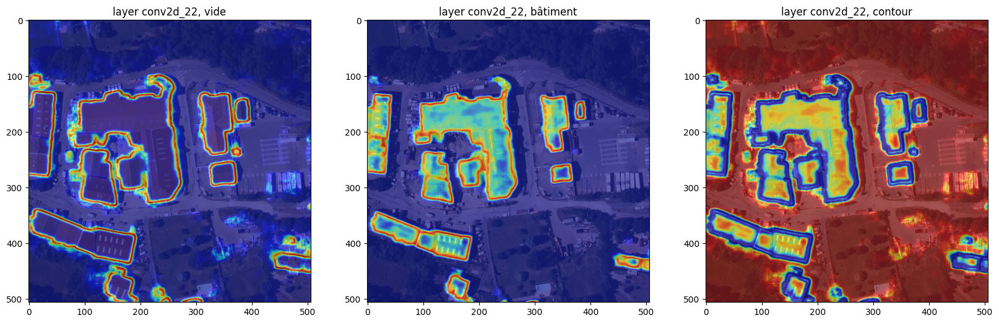

In [ ]:
layer_name = [layer.name for layer in all_layers_target][36]
fig, axs = plt.subplots(1, 3, figsize = (20, 6))
for col, i in enumerate(range(3)):
  superimposed_img = np.uint8(dict_heatmap[layer_name][i]['superposed_img'])
  axs[col].imshow(superimposed_img)
  axs[col].set_title('layer {}, {}'.format(layer_name, channels_pred[i]))
plt.show()

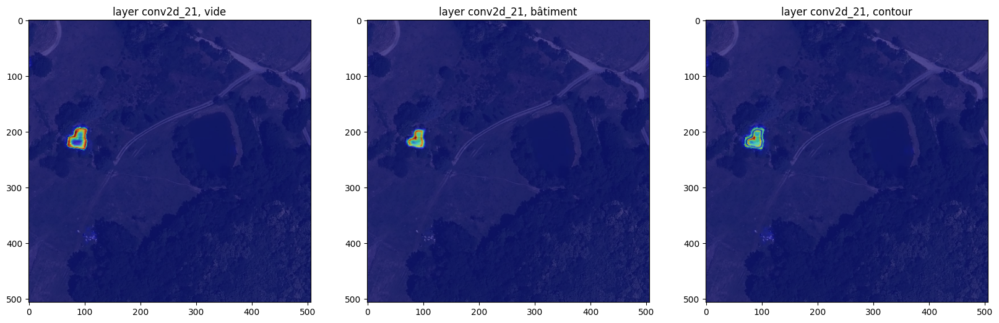

In [ ]:
layer_name = [layer.name for layer in all_layers_target][35]
fig, axs = plt.subplots(1, 3, figsize = (20, 6))
for col, i in enumerate(range(3)):
  superimposed_img = np.uint8(dict_heatmap[layer_name][i]['superposed_img'])
  axs[col].imshow(superimposed_img)
  axs[col].set_title('layer {}, {}'.format(layer_name, channels_pred[i]))
plt.show()

In [ ]:
layer_name = [layer.name for layer in all_layers_target][35]
px.imshow(np.uint8(dict_heatmap[layer_name][1]['superposed_img']))

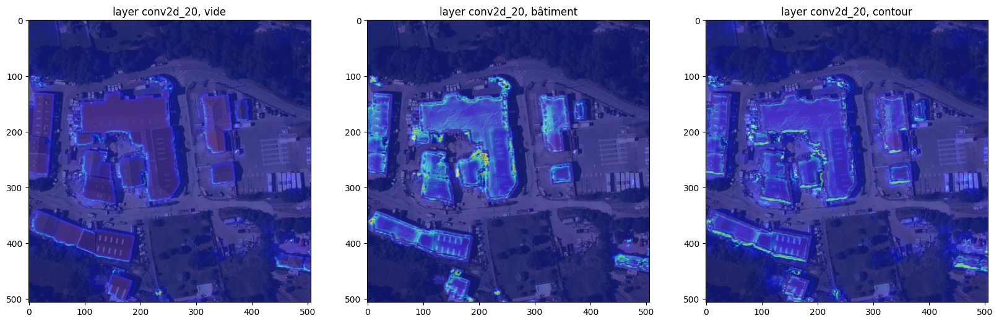

In [ ]:
layer_name = [layer.name for layer in all_layers_target][34]
fig, axs = plt.subplots(1, 3, figsize = (20, 6))
for col, i in enumerate(range(3)):
  superimposed_img = np.uint8(dict_heatmap[layer_name][i]['superposed_img'])
  axs[col].imshow(superimposed_img)
  axs[col].set_title('layer {}, {}'.format(layer_name, channels_pred[i]))
plt.show()

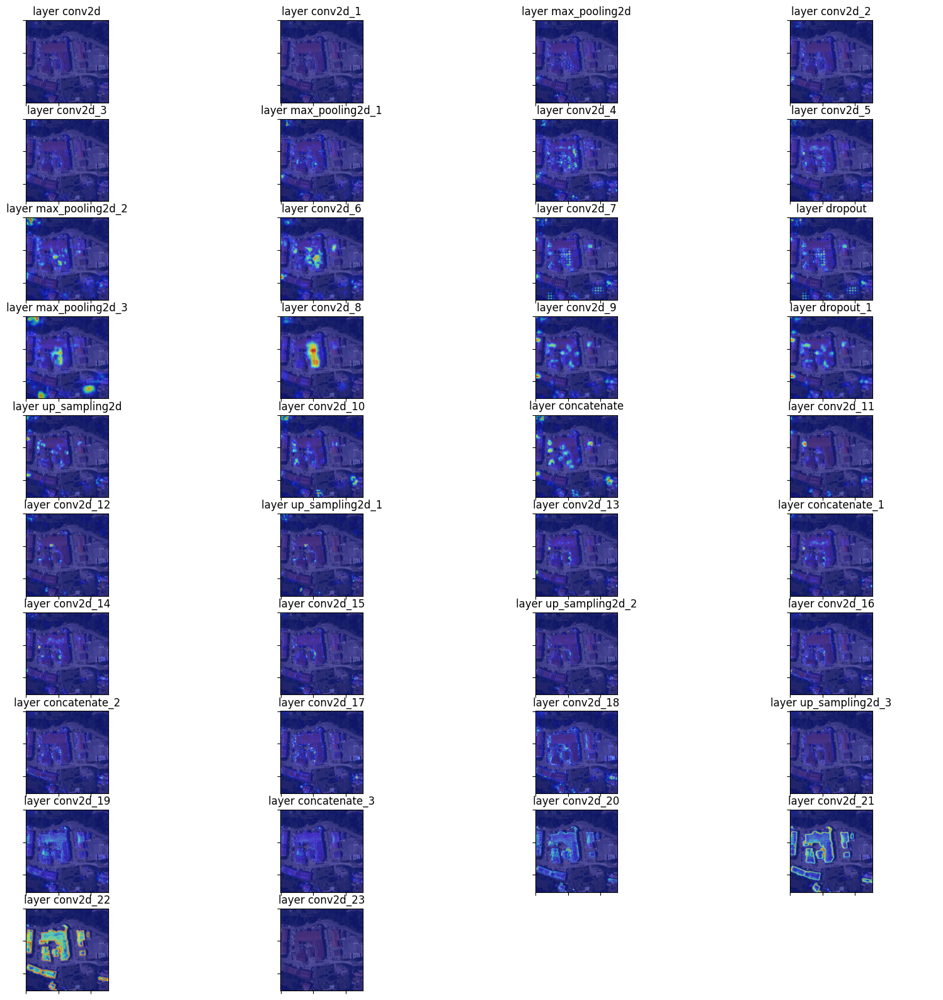

In [ ]:
i = 1
fig, axs = plt.subplots(int(np.ceil(len(dict_heatmap.keys()) / 4)), 4, figsize = (20, 20))
for col in range(4):
  for row in range(int(np.ceil(len(dict_heatmap.keys()) / 4))):
    if col + row*4 < len(dict_heatmap.keys()):
      layer_name = [layer.name for layer in all_layers_target][col + row*4]
      superimposed_img = np.uint8(dict_heatmap[layer_name][i]['superposed_img'])
      axs[row, col].imshow(superimposed_img)
      axs[row, col].set_title('layer {}'.format(layer_name))
      axs[row, col].set(xticklabels=[])
      axs[row, col].set(yticklabels=[])
    else:
      axs[row, col].axis('off')
plt.show()

## Streamlit

In [ ]:
X_size = Y_size = 1000
coords_scale = 0.2
X0 = 644326.03
Y0 = 6860333.65

raster_transform = rasterio.transform.Affine(coords_scale, 0.0, X0,
                          0.0, coords_scale, Y0)
xmin, ymin = raster_transform*(0, 0)
xmax, ymax = raster_transform*(X_size, Y_size)
request_wms = 'https://data.geopf.fr/wms-r?LAYERS=HR.ORTHOIMAGERY.ORTHOPHOTOS&FORMAT=image/tiff&SERVICE=WMS&VERSION=1.3.0&REQUEST=GetMap&STYLES=&CRS=EPSG:2154&BBOX={},{},{},{}&WIDTH={}&HEIGHT={}'.format(
   xmin, ymin, xmax, ymax, X_size, Y_size)
response_wms = requests.get(request_wms).content
image = Image.open(BytesIO(response_wms))